In [1]:
import spatialdata as sd
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import squidpy as sq
import anndata as ad
from matplotlib.colors import ListedColormap

import pickle
import warnings
warnings.filterwarnings("ignore")       

/software/cellgen/team298/ls34/NEMO2/lib/python3.10/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/software/cellgen/team298/ls34/NEMO2/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)


In [2]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.settings.figdir = "supp"
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(25,25))


In [3]:
#adata=sc.read_h5ad('/nfs/team298/ls34/adult_skin/final_adatas/adata_combined_new.h5ad.v8_nohealthy')
PATH = '/nfs/team298/ls34/adult_skin/final_adatas/adata_combined_new.h5ad.final.filtered'
adata=sc.read_h5ad(PATH)
adata_5k=adata[adata.obs["tech"]=="xenium"].copy()
adata=adata[adata.obs["tech"]!="xenium"].copy()

#adata=sc.read_h5ad('/nfs/team298/ls34/adult_skin/final_adatas/adata_combined_new.h5ad.final.filtered.scrna')

import gc
gc.collect()


#adata=sc.read_h5ad(PATH2)
def remove_markers(LIST):
    try: 
        LIST = {key: [gene for gene in genes if gene in adata.var_names] 
                           for key, genes in LIST.items()}
    except: 
        LIST =[gene for gene in LIST if gene in adata.var_names]
    return LIST

 

 

In [4]:
adata_5k.obs["Annotation"]=adata_5k.obs["lvl5_annotation"]
adata_5k.obs["Annotation"].value_counts()

# Perineural mac

0 True
Baseline_never_CE3-SKI-28-FO-2-S22-C1 - Cell count:  1


/tmp/ipykernel_1471679/1214957651.py:19: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_i.obs["test"] = [x if x == CELL_TYPE or "Schwann" in x else "Other" for x in adata_i.obs["Annotation"]]
/software/cellgen/team298/ls34/NEMO2/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:976: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


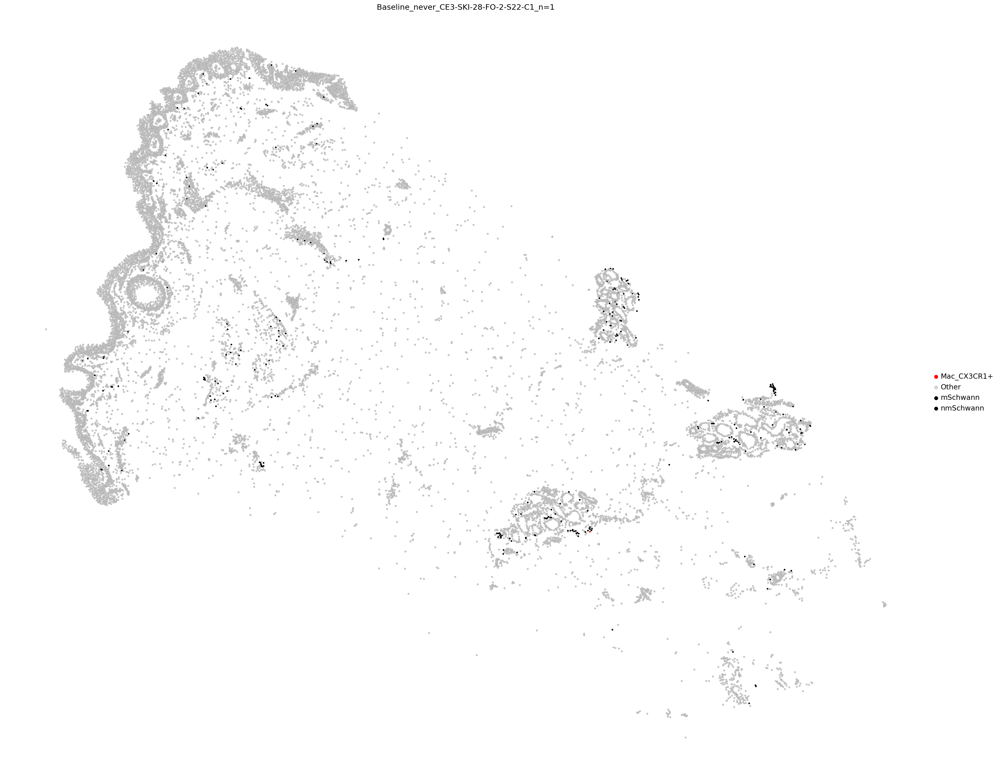

In [10]:
CELL_TYPE = 'Mac_CX3CR1+'
MIN_CELL_COUNT=1


i=0
#adata_5k=adata_5k[adata_5k.obs["Site_status_binary"]=="Lesional"]
for tissue_section_id in [ 'Baseline_never_CE3-SKI-28-FO-2-S22-C1']:
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    niche_names_found = adata_i.obs["Annotation"].unique()
    STATUS =  adata_i.obs["info_id6"].unique()[0]
    print(i, CELL_TYPE in niche_names_found)
    if CELL_TYPE in niche_names_found:
        CELL_COUNT_IN_SECTION=adata_i[adata_i.obs["Annotation"]==CELL_TYPE].shape[0]
        print(tissue_section_id, "- Cell count: ", CELL_COUNT_IN_SECTION)

        if CELL_COUNT_IN_SECTION >= MIN_CELL_COUNT: 
            i=i+1
            adata_i.obs["test"] = [x if x == CELL_TYPE or "Schwann" in x else "Other" for x in adata_i.obs["Annotation"]]
            NUM = ord(CELL_TYPE[0])
            if NUM <79:
                custom_palette =ListedColormap([  "red",  "lightgrey", 'black',])
            else:
                custom_palette = ListedColormap([  "lightgrey", "red", 'black'])
            #print(x)
            if tissue_section_id =="Baseline_never_CE3-SKI-28-FO-2-S22-C1":
                sq.pl.spatial_scatter(
                        adata_i,
                        library_id="spatial",
                        shape=None,
                        color="test",
                        size=30,
                        vmax=1,
                        title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
                        palette=custom_palette,
                      edgecolor='black',
                        linewidth=0.1,
                        #ax=ax,
                        #legend_loc="on data"  # Disable the legend for each subplot
                    )
         
            else:
                1

                                    #ax=ax,
                                    #legend_loc="on data"  # Disable the legend for each subplot
 
        else:
             print(STATUS, " - does not contain ", CELL_TYPE, ". Count is " , CELL_COUNT_IN_SECTION,)# " - i=", i)

# Mac dotplot

In [12]:
CATEGORY="lvl5_annotation"

# ILC3

In [5]:
file_path = '/nfs/team298/ls34/color_for_adult_skin2.pkl' 

with open(file_path, 'rb') as f:   # rb = read-binary
    COLOUR_MAP = pickle.load(f)



In [6]:
# adata_5k[adata_5k.obs["lvl5_annotation"]=='ILC3_CCL1+PTGDS+'].obs.info_id6.value_counts()


info_id6
BK39_Week 12                              17
BK18_Lesional Baseline                    13
BK25_Week 12                              10
3D_BK22_Lesional_baseline-A1               9
BK22_Lesional Baseline                     8
BK30_Day 14                                8
BK39_Lesional Baseline                     8
BK21_Lesional Baseline                     7
3D_BK22_Lesional_baseline-D1               6
BK27_Week 12                               6
Lesional_CE3-SKI-24-FO-1-S22-A1            5
BK43_Never Lesional                        4
3D_BK22_Lesional_baseline-B1               4
3D_BK25_week12-D2                          4
BK23_Week 12                               4
BK30_Non-lesional Baseline                 4
3D_BK22_Lesional_baseline-A2               3
BK22_Non-lesional Baseline                 3
3D_BK22_Lesional_baseline-D2               3
3D_BK22_Lesional_baseline-C2               2
3D_BK22_Lesional_baseline-B2               2
BK30_Lesional Baseline                     2
B

/tmp/ipykernel_2879852/3522995933.py:12: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
/tmp/ipykernel_2879852/3522995933.py:18: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


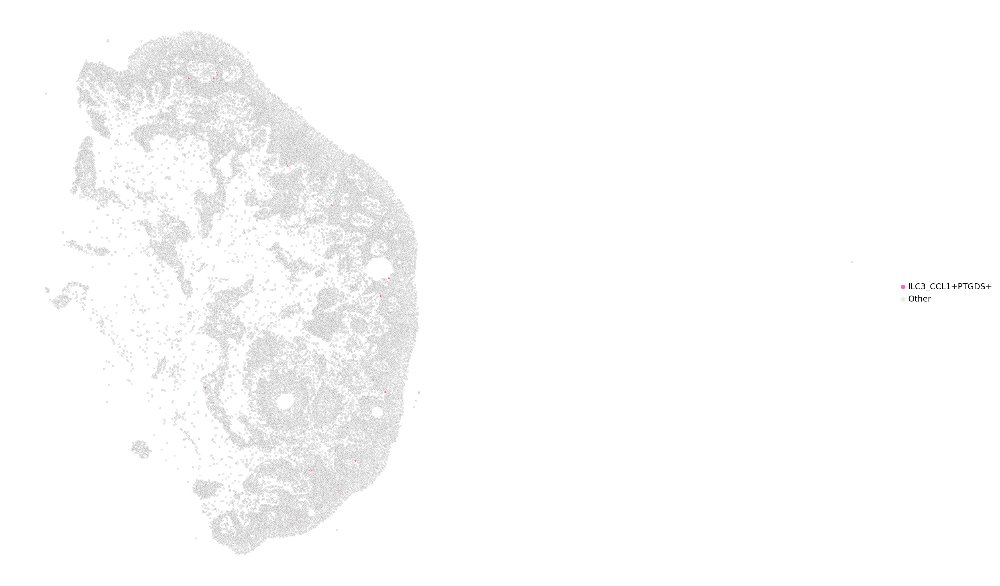

/tmp/ipykernel_2879852/3522995933.py:12: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
/tmp/ipykernel_2879852/3522995933.py:18: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


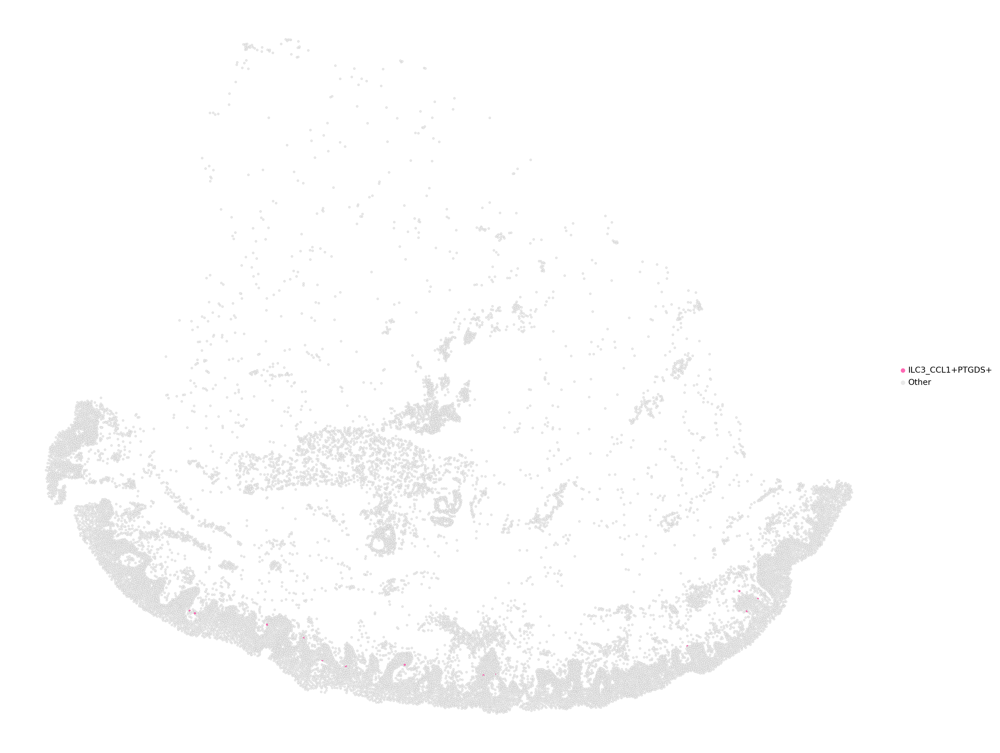

In [13]:
CELL_TYPE = 'ILC3_CCL1+PTGDS+'
MIN_CELL_COUNT=9


i=0

for tissue_section_id in ['BK39_Week 12',
                          'BK18_Lesional Baseline',
                         # "BK25_Week 12",
                        ]  :
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
    NUM = ord(CELL_TYPE[0])
    if NUM <79:
        custom_palette = [ COLOUR_MAP[CELL_TYPE],  "#E9E9E9"]
    else:
        custom_palette = [  "#E9E9E9", COLOUR_MAP[CELL_TYPE]]
    sc.pl.spatial(
            adata_i,
            #library_id="spatial",
            #shape=None,
            color="test",
            spot_size=12,
            vmax=1,
        title='',
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
            palette=custom_palette,
            edgecolor='black',
            linewidth=0.05,
        save=f"{tissue_section_id}_ILC3CCL1.pdf"
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
#     sq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="lvl5_annotation",
#             size=30,
#             vmax=1,
#             #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
#           #  palette=custom_palette,
#             edgecolor='black',
#             linewidth=0.01,
#             #ax=ax,
#             #legend_loc="on data"  # Disable the legend for each subplot
#         )
# #             if i >5:
# #                 print("6 samples found already ... Terminate")
# #                 break


# All ILCs

In [14]:
adata=adata_5k
[x for x in adata.obs["Annotation"].unique() if x.startswith("ILC")]

['ILC3', 'ILC2', 'ILC3_CCL1+PTGDS+', 'ILC1', 'ILC1_NCR2+P2RX7+', 'ILC_Prolif']

In [16]:
# file_path = '/nfs/team298/ls34/color_for_adult_skin2.pkl' import pickle

# # Load the dict back
# with open('/nfs/team298/ls34/niche_colors.pkl', 'rb') as f:   # rb = read-binary
#     colors_new2_loaded = pickle.load(f)



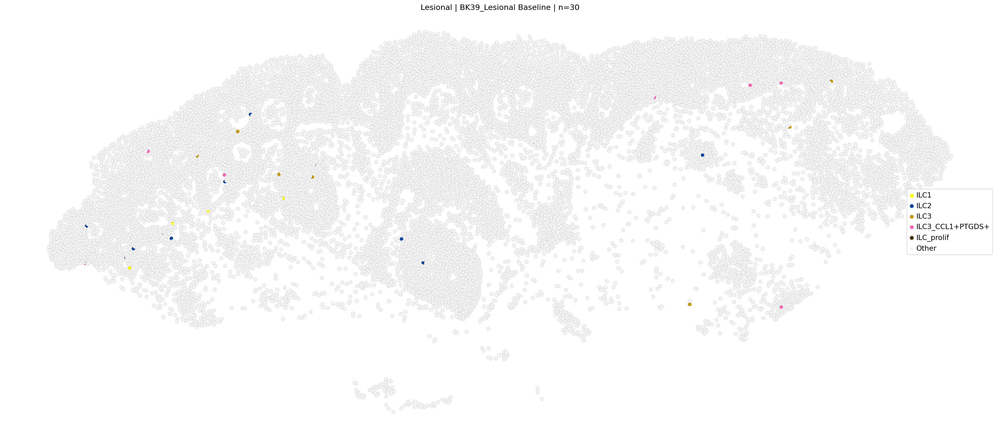

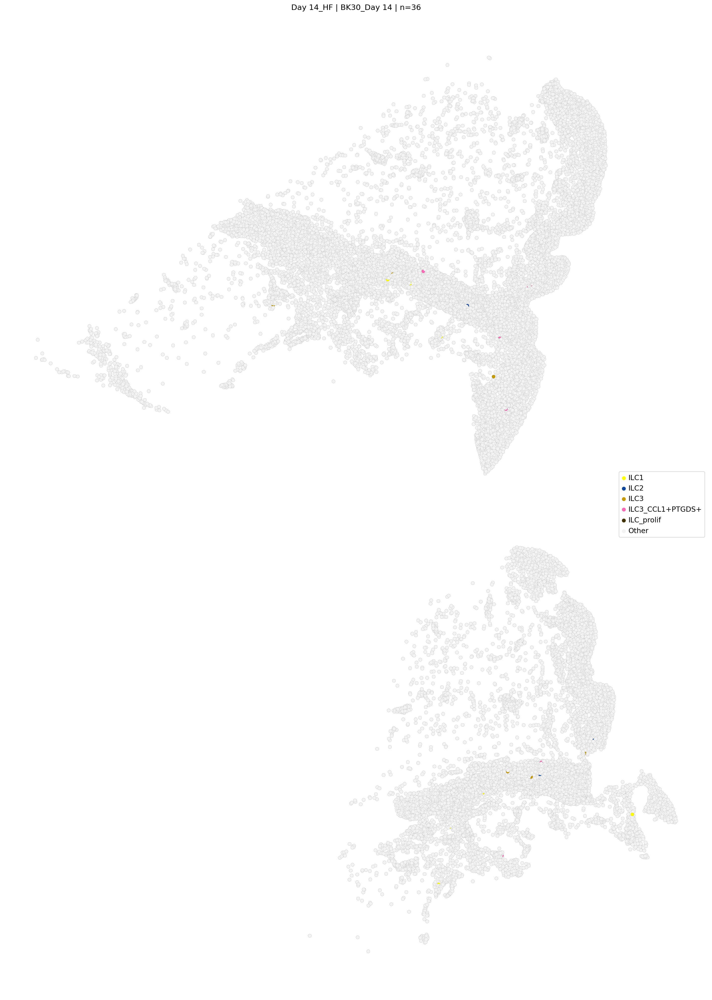

In [17]:


TARGET_TYPES   = {"ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+" , "ILC_prolif"}
# COLOUR_MAP     = {                 # hexes = colour-blind–safe “Set1”
#     "ILC1":  "#e41a1c",            # red
#     "ILC2":  "#377eb8",            # blue
#     "ILC3":  "#4daf4a",            # green
#     "ILC3_CCL1+PTGDS+": "#FFA500",
#      "ILC_prolif": "#000000",
#     "Other": "#EFEFEF"
# }
MIN_CELL_COUNT = 1
i = 0

for tissue_section_id in adata_5k.obs["sample_id"].unique():
    adata_i = adata_5k[adata_5k.obs["sample_id"] == tissue_section_id]
    status  = adata_i.obs["Site_status"].iloc[0]
    annos   = adata_i.obs["Annotation"]

    # skip sections with none of the target types
    if not TARGET_TYPES.intersection(annos.unique()):
        continue

    # count target cells
    target_mask       = annos.isin(TARGET_TYPES)
    target_cell_count = int(target_mask.sum())
    if target_cell_count < MIN_CELL_COUNT:
        continue

    # assign plotting group per cell
    
    # make sure "Other" is an allowed category BEFORE we call .where
    if "Other" not in annos.cat.categories:
        annos = annos.cat.add_categories(["Other"])

    # create the plotting series
    plot_group = annos.where(annos.isin(TARGET_TYPES), "Other")
    plot_group = (
        plot_group.astype("category")
                  .cat.set_categories(["ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+",  "ILC_prolif",  "Other"])
    )
    adata_i.obs["plot_group"] = plot_group
    
    
#     adata_i.obs["plot_group"] = annos.where(annos.isin(TARGET_TYPES), "Other")
#     adata_i.obs["plot_group"] = (
#         adata_i.obs["plot_group"]
#         .astype("category")
#         .cat.set_categories(["ILC1", "ILC2", "ILC3", "Other"])
#     )

    # palette must be in category order
    palette = ListedColormap([COLOUR_MAP[c] for c in adata_i.obs["plot_group"].cat.categories])
    if target_cell_count >10 and "BK39_L" in tissue_section_id:
        sq.pl.spatial_scatter(
            adata_i,
            library_id="spatial",
            shape=None,
            color="plot_group",
            size=100,
            vmax=1,
            title=f"{status} | {tissue_section_id} | n={target_cell_count}",
            palette=palette,
            legend_loc=None,
            linewidth=0.05,
            edgecolor='black',
            save="ILC_plot.pdf"

        )
        aq.pl.spatial_scatter(
            adata_i,
            library_id="spatial",
            shape=None,
            color="plot_group",
            size=100,
            vmax=1,
            title=f"{status} | {tissue_section_id} | n={target_cell_count}",
            palette=palette,
            #legend_loc=None,
            linewidth=0.05,
            edgecolor='black',
            save="ILC_plot_legend.pdf"

        )
    if target_cell_count >10 and "BK30_Day 14" in tissue_section_id:
        sq.pl.spatial_scatter(
            adata_i,
            library_id="spatial",
            shape=None,
            color="plot_group",
            size=150,
            vmax=1,
            title=f"{status} | {tissue_section_id} | n={target_cell_count}",
            palette=palette,
            legend_loc="right",
            linewidth=0.05,
            edgecolor='black'

        )
    i += 1



In [18]:
adata_5k[adata_5k.obs["lvl5_annotation"]=="Merkel cell"].obs['info_id6'].value_counts()

info_id6
BK23_Lesional Baseline                          3
BK24_Lesional Baseline                          2
BK23_Week 12                                    2
BK51_Past Lesional                              2
BK49_Past Lesional                              2
BK22_Lesional Baseline                          1
BK20_Week 12                                    1
3D_BK22_Lesional_baseline-A2                    1
3D_BK22_Lesional_baseline-D1                    1
BK30_Non-lesional Baseline                      1
BK18_Non-lesional Baseline                      1
BK39_Non-lesional Baseline                      1
BK39_Lesional Baseline                          1
BK49_Never Lesional                             1
BK50_Never Lesional                             1
BK51_Past Lesional wk8 relaspe                  1
Baseline_never_CE4-SKI-21-FO-1-S22_replicate    1
Baseline_resolved_CE6-SKI-20-FO-1-S22-C2        1
Baseline_resolved_CE6-SKI-28-FO-1-S22-B2        1
Lesional_CE4-SKI-27-FO-4-S22-A2          

In [19]:


# TARGET_TYPES   = {"Me"}
# # COLOUR_MAP     = {                 # hexes = colour-blind–safe “Set1”
# #     "ILC1":  "#e41a1c",            # red
# #     "ILC2":  "#377eb8",            # blue
# #     "ILC3":  "#4daf4a",            # green
# #     "ILC3_CCL1+PTGDS+": "#FFA500",
# #      "ILC_prolif": "#000000",
# #     "Other": "#EFEFEF"
# # }
# MIN_CELL_COUNT = 1
# i = 0

# for tissue_section_id in adata_5k.obs["sample_id"].unique():
#     adata_i = adata_5k[adata_5k.obs["sample_id"] == tissue_section_id]
#     status  = adata_i.obs["Site_status"].iloc[0]
#     annos   = adata_i.obs["Annotation"]

#     # skip sections with none of the target types
#     if not TARGET_TYPES.intersection(annos.unique()):
#         continue

#     # count target cells
#     target_mask       = annos.isin(TARGET_TYPES)
#     target_cell_count = int(target_mask.sum())
#     if target_cell_count < MIN_CELL_COUNT:
#         continue

#     # assign plotting group per cell
    
#     # make sure "Other" is an allowed category BEFORE we call .where
#     if "Other" not in annos.cat.categories:
#         annos = annos.cat.add_categories(["Other"])

#     # create the plotting series
#     plot_group = annos.where(annos.isin(TARGET_TYPES), "Other")
#     plot_group = (
#         plot_group.astype("category")
#                   .cat.set_categories(["ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+",  "ILC_prolif",  "Other"])
#     )
#     adata_i.obs["plot_group"] = plot_group
    
    
# #     adata_i.obs["plot_group"] = annos.where(annos.isin(TARGET_TYPES), "Other")
# #     adata_i.obs["plot_group"] = (
# #         adata_i.obs["plot_group"]
# #         .astype("category")
# #         .cat.set_categories(["ILC1", "ILC2", "ILC3", "Other"])
# #     )

#     # palette must be in category order
#     palette = ListedColormap([COLOUR_MAP[c] for c in adata_i.obs["plot_group"].cat.categories])
#     if target_cell_count >10 and "BK39_L" in tissue_section_id:
#         sq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="plot_group",
#             size=150,
#             vmax=1,
#             title=f"{status} | {tissue_section_id} | n={target_cell_count}",
#             palette=palette,
#             legend_loc="right",
#             linewidth=0.05,
#             edgecolor='black',
#             save="ILC_plot.pdf"

#         )
#     if target_cell_count >10 and "BK30_Day 14" in tissue_section_id:
#         sq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="plot_group",
#             size=150,
#             vmax=1,
#             title=f"{status} | {tissue_section_id} | n={target_cell_count}",
#             palette=palette,
#             legend_loc="right",
#             linewidth=0.05,
#             edgecolor='black'

#         )
#     i += 1



In [20]:
# TARGET_TYPES   = {"ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+" , "ILC_prolif"}
# # COLOUR_MAP     = {                 # hexes = colour-blind–safe “Set1”
# #     "ILC1":  "#e41a1c",            # red
# #     "ILC2":  "#377eb8",            # blue
# #     "ILC3":  "#4daf4a",            # green
# #     "ILC3_CCL1+PTGDS+": "#FFA500",
# #      "ILC_prolif": "#000000",
# #     "Other": "#EFEFEF"
# # }
# MIN_CELL_COUNT = 1
# i = 0

# for tissue_section_id in adata_5k.obs["sample_id"].unique():
#     adata_i = adata_5k[adata_5k.obs["sample_id"] == tissue_section_id]
#     status  = adata_i.obs["Site_status"].iloc[0]
#     annos   = adata_i.obs["Annotation"]

#     # skip sections with none of the target types
#     if not TARGET_TYPES.intersection(annos.unique()):
#         continue

#     # count target cells
#     target_mask       = annos.isin(TARGET_TYPES)
#     target_cell_count = int(target_mask.sum())
#     if target_cell_count < MIN_CELL_COUNT:
#         continue

#     # assign plotting group per cell
    
#     # make sure "Other" is an allowed category BEFORE we call .where
#     if "Other" not in annos.cat.categories:
#         annos = annos.cat.add_categories(["Other"])

#     # create the plotting series
#     plot_group = annos.where(annos.isin(TARGET_TYPES), "Other")
#     plot_group = (
#         plot_group.astype("category")
#                   .cat.set_categories(["ILC1", "ILC2", "ILC3", "ILC3_CCL1+PTGDS+",  "ILC_prolif",  "Other"])
#     )
#     adata_i.obs["plot_group"] = plot_group
#     palette = ListedColormap([COLOUR_MAP[c] for c in adata_i.obs["plot_group"].cat.categories])
#     if target_cell_count >10:
#         sq.pl.spatial_scatter(
#             adata_i,
#             library_id="spatial",
#             shape=None,
#             color="plot_group",
#             size=30,
#             vmax=1,
#             title=f"{status} | {tissue_section_id} | n={target_cell_count}",
#             palette=palette,
#             legend_loc="right",
#             linewidth=0.05,
#             edgecolor='black'

#         )

#     i += 1

    

In [21]:
# [x for x in adata.obs.Annotation.unique() if x.startswith("ILC")]

# ['ILC2/3', 'ILC1/NK', 'ILC_prolif', 'ILC3', 'ILC2', 'ILC1']


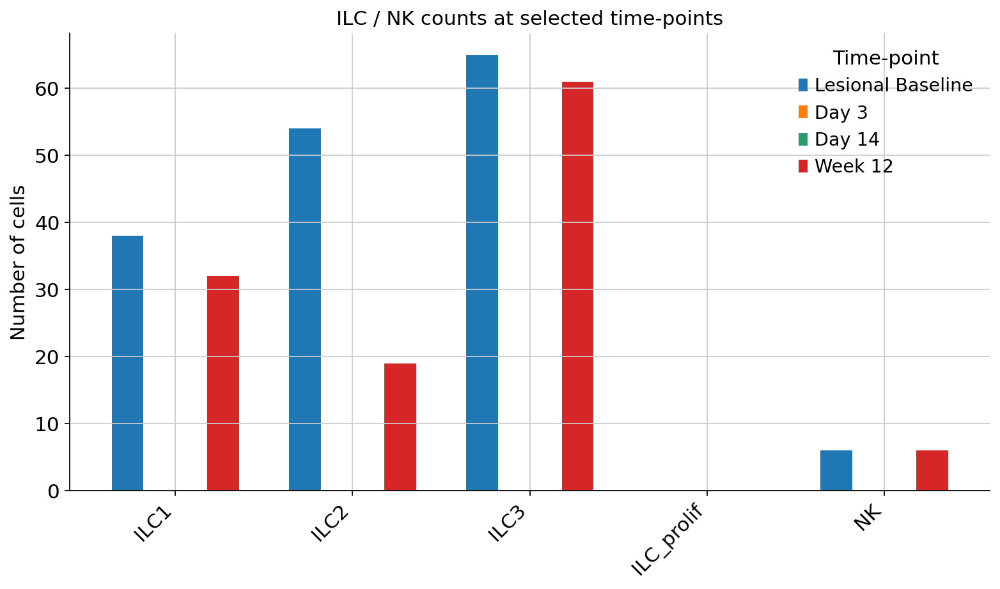

In [22]:
# import matplotlib.pyplot as plt
# import pandas as pd
# import numpy as np

# # ---- 1.  Define the order you want on each axis ----------------------------
# CELL_TYPES  = ["ILC1", "ILC2", "ILC3", "ILC_prolif", "NK"]
# adata_i=adata[adata.obs["Patient_status"]=="AD"]
# # make sure the column names are right for your AnnData
# df = (
#     adata_i.obs
#          .loc[adata.obs["Annotation"].isin(CELL_TYPES),           # keep only those five
#               ["Annotation", "Timepoint"]]
#          .groupby(["Annotation", "Timepoint"])
#          .size()                              # counts
#          .unstack(fill_value=0)               # cell_type × timepoint matrix
#          .reindex(CELL_TYPES)                 # guarantee order, even if zeros
# )
# df


# import matplotlib.pyplot as plt
# import numpy as np

# # ------------------------------------------------------------------
# # 0.  Decide the four time-points you want on each bar cluster
# # ------------------------------------------------------------------
# TP = ["Lesional Baseline", "Day 3", "Day 14", "Week 12"]   # <- edit

# # ------------------------------------------------------------------
# # 1.  Ensure ordering and fill missing with zero
# # ------------------------------------------------------------------
# CELL_TYPES = ["ILC1", "ILC2", "ILC3", "ILC_prolif", "NK"]

# plot_df = (
#     df.reindex(index=CELL_TYPES, columns=TP)   # re-order; introduces NaN if missing
#       .fillna(0)                               # replace NaN with zero counts
#       .astype(int)
# )

# # ------------------------------------------------------------------
# # 2.  Grouped bar plot
# # ------------------------------------------------------------------
# fig, ax = plt.subplots(figsize=(10, 6))
# width = 0.18                               # width of each bar
# x      = np.arange(len(CELL_TYPES))        # positions for cell-type groups

# for j, tp in enumerate(plot_df.columns):
#     ax.bar(x + j*width,
#            plot_df[tp],
#            width,
#            label=tp)

# ax.set_xticks(x + width*1.5)
# ax.set_xticklabels(CELL_TYPES, rotation=45, ha="right")
# ax.set_ylabel("Number of cells")
# ax.set_title("ILC / NK counts at selected time-points")
# ax.legend(title="Time-point", frameon=False)
# ax.spines[['top', 'right']].set_visible(False)

# plt.tight_layout()
# plt.show()

In [23]:
adata.obs["Patient_status"].value_counts()

Patient_status
AD                      627676
Psoriasis               211945
3d_Lesional_baseline    175557
3d_Week12               158233
Healthy                  59315
Name: count, dtype: int64

In [24]:
# import matplotlib.pyplot as plt
# import pandas as pd
# import numpy as np

# # ---- 1.  Define the order you want on each axis ----------------------------
# CELL_TYPES  = ["ILC1", "ILC2", "ILC3", "ILC_prolif", "NK"]
# adata_i=adata[adata.obs["Patient_status"]!="AD"]
# # make sure the column names are right for your AnnData
# df = (
#     adata_i.obs
#          .loc[adata.obs["Annotation"].isin(CELL_TYPES),           # keep only those five
#               ["Annotation", "Timepoint"]]
#          .groupby(["Annotation", "Timepoint"])
#          .size()                              # counts
#          .unstack(fill_value=0)               # cell_type × timepoint matrix
#          .reindex(CELL_TYPES)                 # guarantee order, even if zeros
# )
# df


Timepoint,Lesional Baseline,Never Lesional,Non-lesional Baseline,Week 8 (resolved)
Annotation,,,,
ILC1,62.0,2.0,2.0,1.0
ILC2,11.0,0.0,0.0,1.0
ILC3,30.0,14.0,17.0,27.0
ILC_prolif,NaN,NaN,NaN,NaN
NK,3.0,4.0,4.0,6.0


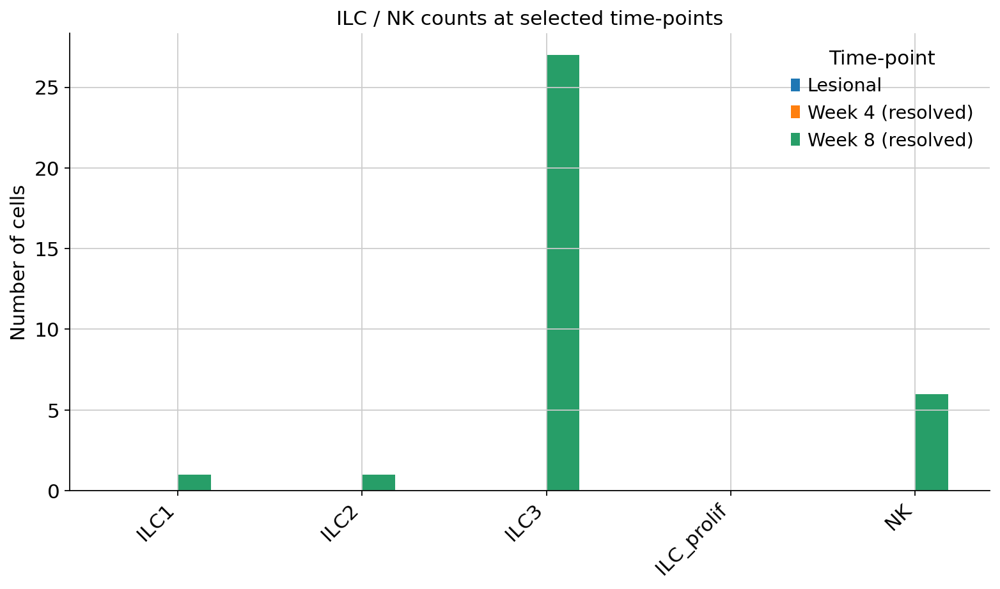

In [25]:


# import matplotlib.pyplot as plt
# import numpy as np

# # ------------------------------------------------------------------
# # 0.  Decide the four time-points you want on each bar cluster
# # ------------------------------------------------------------------
# TP = ["Lesional", "Week 4 (resolved)", "Week 8 (resolved)"]   # <- edit

# # ------------------------------------------------------------------
# # 1.  Ensure ordering and fill missing with zero
# # ------------------------------------------------------------------
# CELL_TYPES = ["ILC1", "ILC2", "ILC3", "ILC_prolif", "NK"]

# plot_df = (
#     df.reindex(index=CELL_TYPES, columns=TP)   # re-order; introduces NaN if missing
#       .fillna(0)                               # replace NaN with zero counts
#       .astype(int)
# )

# # ------------------------------------------------------------------
# # 2.  Grouped bar plot
# # ------------------------------------------------------------------
# fig, ax = plt.subplots(figsize=(10, 6))
# width = 0.18                               # width of each bar
# x      = np.arange(len(CELL_TYPES))        # positions for cell-type groups

# for j, tp in enumerate(plot_df.columns):
#     ax.bar(x + j*width,
#            plot_df[tp],
#            width,
#            label=tp)

# ax.set_xticks(x + width*1.5)
# ax.set_xticklabels(CELL_TYPES, rotation=45, ha="right")
# ax.set_ylabel("Number of cells")
# ax.set_title("ILC / NK counts at selected time-points")
# ax.legend(title="Time-point", frameon=False)
# ax.spines[['top', 'right']].set_visible(False)

# plt.tight_layout()
# plt.show()

In [26]:
adata_ii=adata[adata.obs["Annotation"].str.startswith("ILC")]

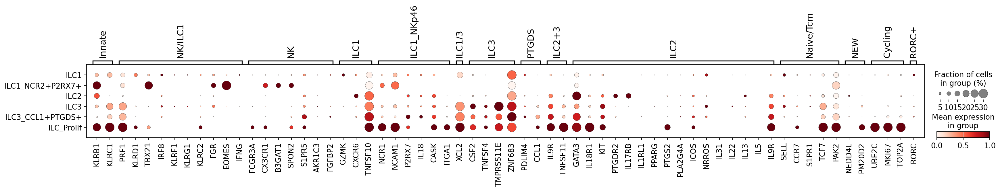

In [27]:
# def remove_markers(LIST):
#     try: 
#         LIST = {key: [gene for gene in genes if gene in adata.var_names] 
#                            for key, genes in LIST.items()}
#     except: 
#         LIST =[gene for gene in LIST if gene in adata.var_names]
#     return LIST

# ALLT2 = {'Innate': [
#   'KLRB1',
#   'KLRC1',
#   'TYROBP',
#   'FCER1G',
# ],
#          "NK/ILC1": ['PRF1','KLRD1','TBX21','IRF8',  'KLRF1',
#   'KLRG1','KLRC2',
#   'KLRC3', 'CEBPD',"FGR", "EOMES", "IFNG"],
#  'NK': [  'FCGR3A',
 
#   'CX3CR1',
#   'CCL4L2',
#   'PRSS23', 'B3GAT1',
#        'SPON2',
#   'S1PR5',
#   'AKR1C3',
#          'FGFBP2',



#   'S100B'],

#          "ILC1": [ "ADGRG3", 'GZMK', 'OASL', 'CXCR6' , "TNFSF10" ],
#          "ILC1_NKp46":  [ 'NCR1', 'NCAM1',  'P2RX7',   'ZNF407', "IL18",'ZBTB20', 'CASK', "ITGA1"],
#  'ILC1/3': ['XCL1', 'XCL2', ],
#           'ILC3': ['ID3','CSF2', 'KRT86',
#  # 'ZBTB46',
#   'TNFSF4',
#   'SPINK2',
#   'RAMP1',
#   'MB',
#   'KLRF2',
#   'TMPRSS11E', "ZNF683"],
#            'PTGDS': [  'PTGDS', 'PDLIM4', 'CCL1'],


#  'ILC2+3': ['IL9R', 'TNFSF11'],
#  'ILC2': ['GATA3',  'IL18R1','KIT', 'PTGDR2', 'TNFRSF25',
#           'CRLF2',
#   'IL17RB',
#   'IL1RL1',

#   'PPARG',
#   'PTGS2',
#   'PLA2G4A',
#   #'IL4',

#   'ICOS',
#   'NRROS',     'IL31',
# 'IL22', 'IL13', "IL5",#'PDLIM4', 'CCL1',
#           #'AREG', 'CCR8',
#           'IL9R'],
#  'Naive/Tcm': ['SELL', 'CCR7', 'S1PR1', 'TCF7', 'PAK2', 'ZHX2'],
#         "NEW": ["PLXDC2", "AIF1", "RAB34", "NEDD4L", "PM20D2", "TNRC18", "JCHAIN", ],
#  'Cycling': ['UBE2C', 'MKI67', 'TOP2A'],
#         "RORC+": ["RORC",]
#         }

             
# # sc.pl.dotplot(adata_ii, 
# #               ALLT2,
# #               groupby=CATEGORY,
# #               dendrogram=False, 
# #                 standard_scale="var",
# #              categories_order = [x for x in ORDER_T if x in adata_ii.obs[CATEGORY].unique()]

# #              )


# sc.pl.dotplot(adata_ii, 
#               remove_markers(ALLT2),
#               groupby="Annotation",
#               dendrogram=False, 
#                 standard_scale="var",
#              dot_max=0.3,
# #            categories_order = #['NK',
# #'ILC1/NK','ILC2/3', 'ILC_prolif']

              
#              )




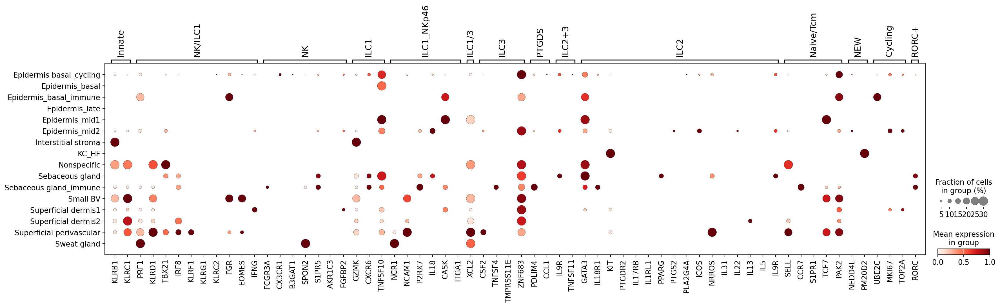

In [28]:
# adata_iii=adata_ii[adata_ii.obs["Annotation"]=="ILC1"]
# sc.pl.dotplot(adata_iii, 
#               remove_markers(ALLT2),
#               groupby="niche11",
#               dendrogram=False, 
#                 standard_scale="var",
#              dot_max=0.3,
# #            categories_order = #['NK',
# #'ILC1/NK','ILC2/3', 'ILC_prolif']

              
#              )

In [29]:
adata_5k[adata_5k.obs["lvl5_annotation"]==CELL_TYPE].obs.niche12.value_counts()

niche12
Perineural          2
Small_BV            2
Hypodermis          1
Reticular_dermis    1
Sebaceous_gland     1
Tzone-like          1
Name: count, dtype: int64

In [30]:
adata_5k[adata_5k.obs["lvl5_annotation"]==CELL_TYPE].obs.Timepoint.value_counts()

Timepoint
Non-lesional Baseline    3
Week 8 (resolved)        3
Never Lesional           2
Name: count, dtype: int64

In [31]:
CELL_TYPE = 'F6: Inflammatory myofibroblast'
MIN_CELL_COUNT=10


i=0
#adata_5k=adata_5k[adata_5k.obs["Site_status_binary"]=="Lesional"]
for tissue_section_id in adata_5k.obs["sample_id"].unique():
    adata_i =  adata_5k[adata_5k.obs["sample_id"]==tissue_section_id]
    niche_names_found = adata_i.obs["Annotation"].unique()
    STATUS =  adata_i.obs["Site_status"].unique()[0]
    print(i, CELL_TYPE in niche_names_found)
#     if tissue_section_id=="output-XETG00335__0044073__BK49-SKI-24-FO-1-s2_BK50-SKI-27-FO-1-s2__20250210__163417":
#         print(tissue_section_id)
#         display(adata_i.obs["Annotation"].value_counts())
    if CELL_TYPE in niche_names_found:
        CELL_COUNT_IN_SECTION=adata_i[adata_i.obs["Annotation"]==CELL_TYPE].shape[0]
        print(tissue_section_id, "- Cell count: ", CELL_COUNT_IN_SECTION)

        if CELL_COUNT_IN_SECTION > MIN_CELL_COUNT:
    #         if i ==0:

    #             sq.pl.spatial_scatter(
    #                 adata_i,
    #                 library_id="spatial",
    #                 shape=None,
    #                 color="Annotation",
    #                 size=1,
    #                 vmax=1,
    #                 title=tissue_section_id,
    #                 #ax=ax,
    #                 #legend_loc="on data"  # Disable the legend for each subplot
    #             )       
            i=i+1

            #print(tissue_section_id)
    #         sq.pl.spatial_scatter(
    #             adata_i,
    #             library_id="spatial",
    #             shape=None,
    #             color="Annotation",
    #             size=5,
    #             vmax=1,
    #             title=tissue_section_id,
    #             #ax=ax,
    #             legend_loc="on data"  # Disable the legend for each subplot
    #         )
            adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["Annotation"]]
            NUM = ord(CELL_TYPE[0])
            if NUM <79:
                custom_palette =ListedColormap([  "red",  "lightgrey"])
            else:
                custom_palette = ListedColormap([  "lightgrey", "red"])
            sq.pl.spatial_scatter(
                    adata_i,
                    library_id="spatial",
                    shape=None,
                    color="test",
                    size=30,
                    vmax=1,
                    title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
                    palette=custom_palette,

                    #ax=ax,
                    #legend_loc="on data"  # Disable the legend for each subplot
                )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break
        else:
             print(STATUS, " - does not contain ", CELL_TYPE, ". Count is " , CELL_COUNT_IN_SECTION,)# " - i=", i)

0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 False
0 True
BK22_Lesional Baseline - Cell count:  2
Lesional  - does not contain  F6: Inflammatory myofibroblast . Count is  2
0 False
0 False
0 True
BK23_Lesional Baseline - Cell count:  1
Lesional  - does not contain  F6: Inflammatory myofibroblast . Count is  1
0 False
0 False
0 True
BK21_Lesional Baseline - Cell count:  1
Lesional  - does not contain  F6: Inflammatory myofibroblast . Count is  1
0 False
0 False
0 False
0 False
0 False
0 True
BK18_Lesional Baseline - Cell count:  1
Lesional  - does not contain  F6: Inflammatory myofibroblast . Count is  1
0 True
BK21_Non-lesional Baseline - Cell count:  1
Non-lesional  - does not contain  F6: Inflammatory myofibroblast . Count is  1
0 False
0 False
0 False
0 False
0 False
0 True
BK39_Week 12 - Cell count:  1
Week 12  - does not contain  F6: Inflammatory myofibroblast . Count is  1
0 False
0 True
BK30_Day 14 - Cell count:  2
Day

In [33]:
adata_5k[adata_5k.obs["lvl5_annotation"]=='F4: DP_HHIP+'].obs.info_id6.value_counts()




info_id6
Lesional_CE4-SKI-27-FO-4-S22_replicate             48
3D_BK25_week12-D2                                  41
Lesional_CE4-SKI-27-FO-4-S22-A2                    19
BK30_Week 12                                       17
Week 8 (resolved)_CE4-SKI-27-FO-3-S22-E2_a         10
3D_BK25_week12-D1orE1a                             10
Week 8 (resolved)_CE4-SKI-27-FO-3-S22_replicate     9
Week 8 (resolved)_CE3-SKI-28-FO-4-S22-E1_b          8
BK30_Day 14                                         6
Week 8 (resolved)_CE5-SKI-27-FO-4-S22_replicate     6
3D_BK25_week12-C2                                   5
BK27_Week 12                                        5
Week 8 (resolved)_CE3-SKI-28-FO-4-S22-E1_a          5
BK43_Never Lesional                                 4
Week 8 (resolved)_CE5-SKI-27-FO-4-S22-E1            4
BK27_Non-lesional Baseline                          4
Baseline_never_CE4-SKI-21-FO-1-S22-C2               3
BK24_Non-lesional Baseline                          3
BK49_Past Lesional 

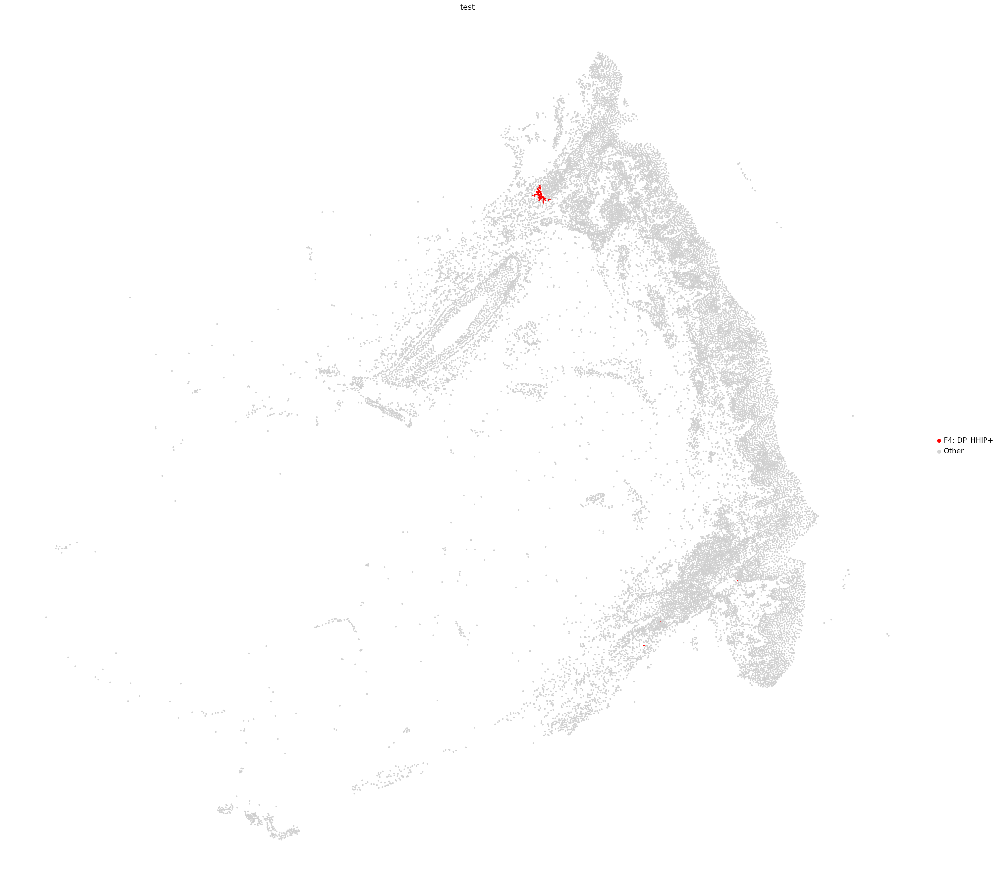

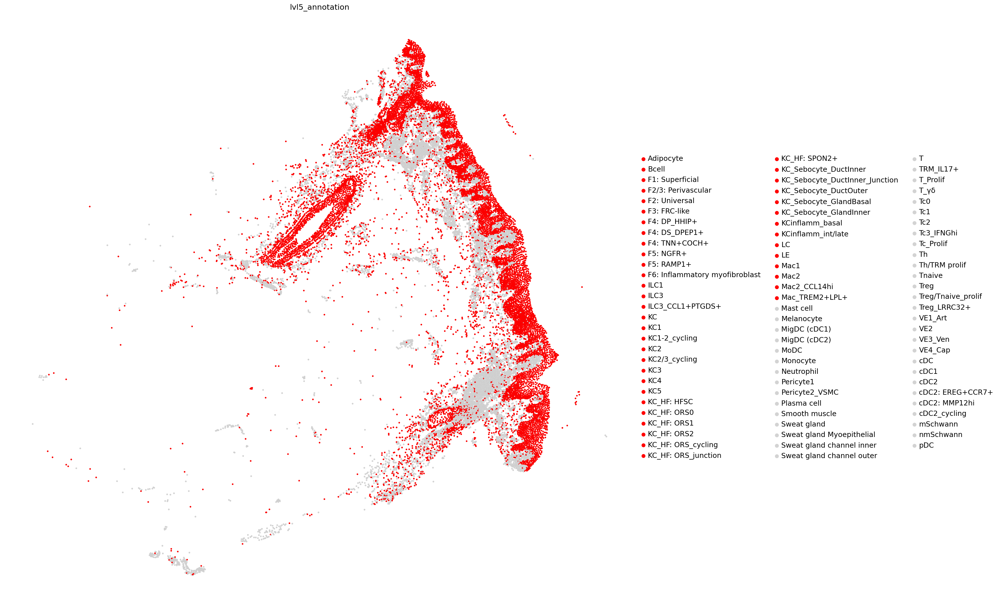

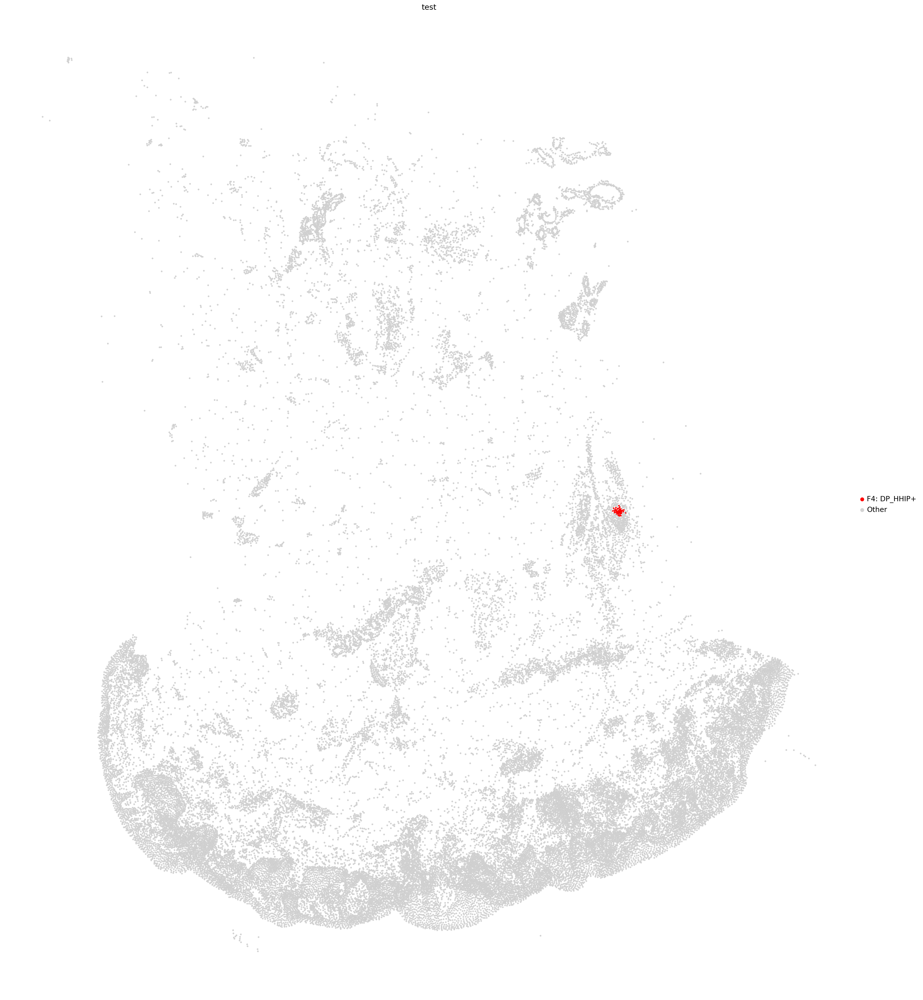

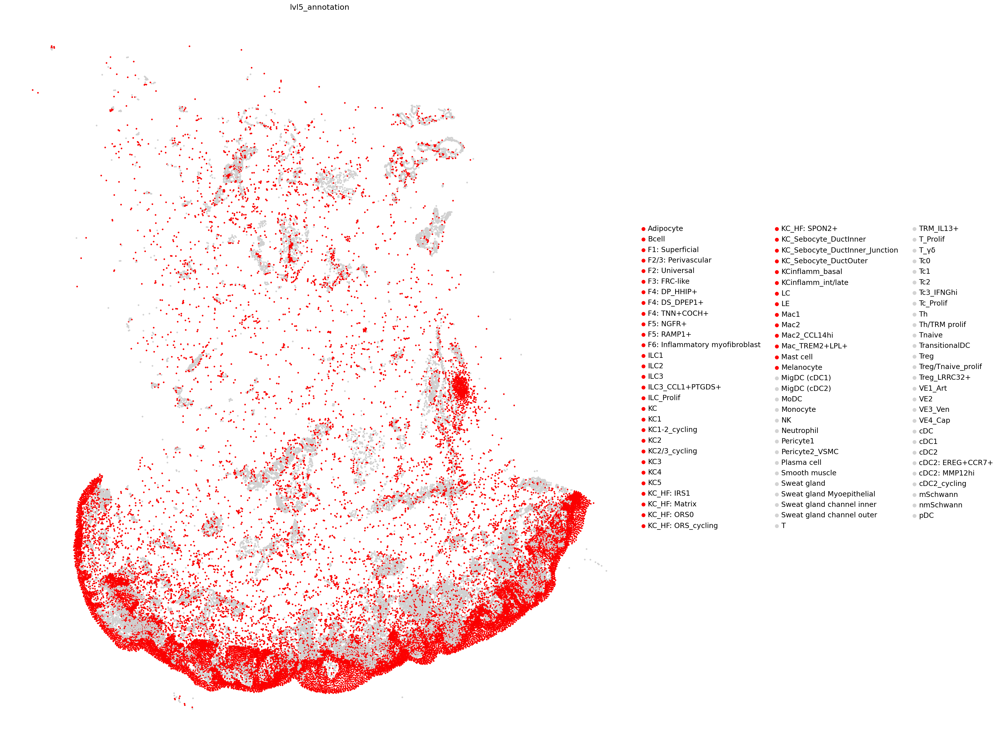

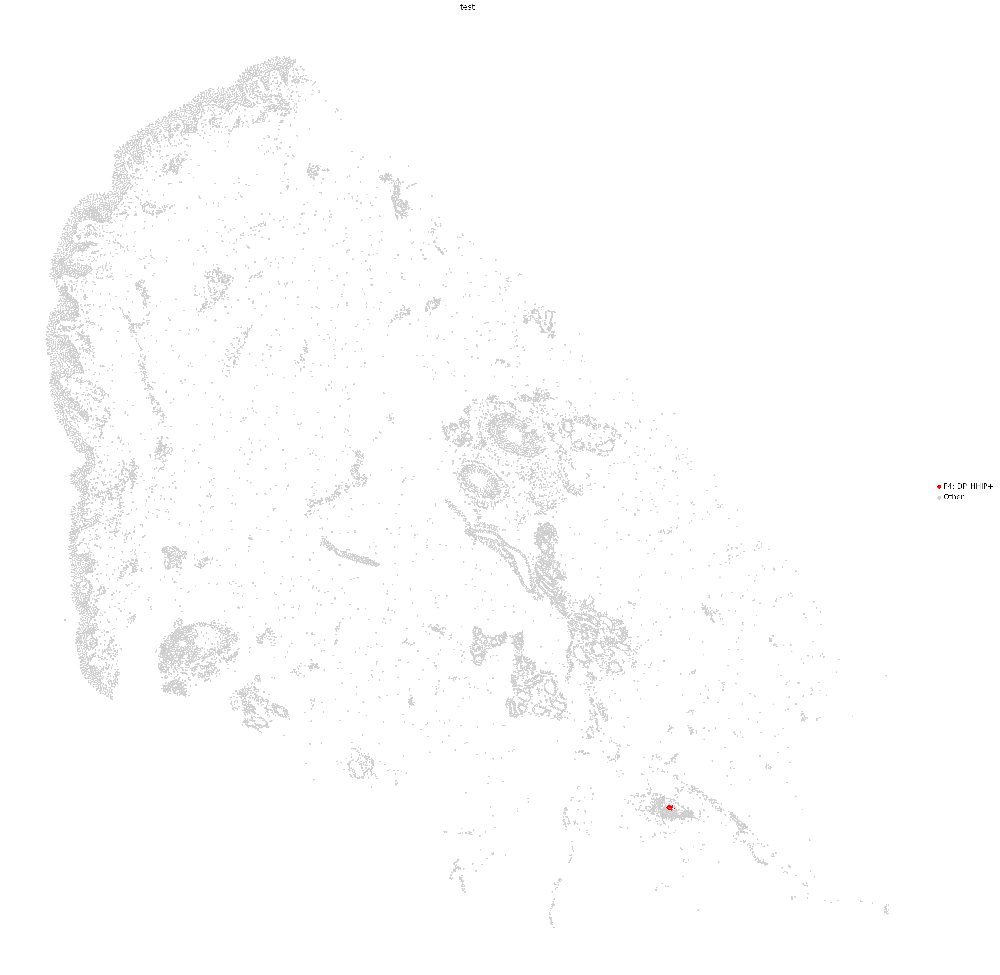

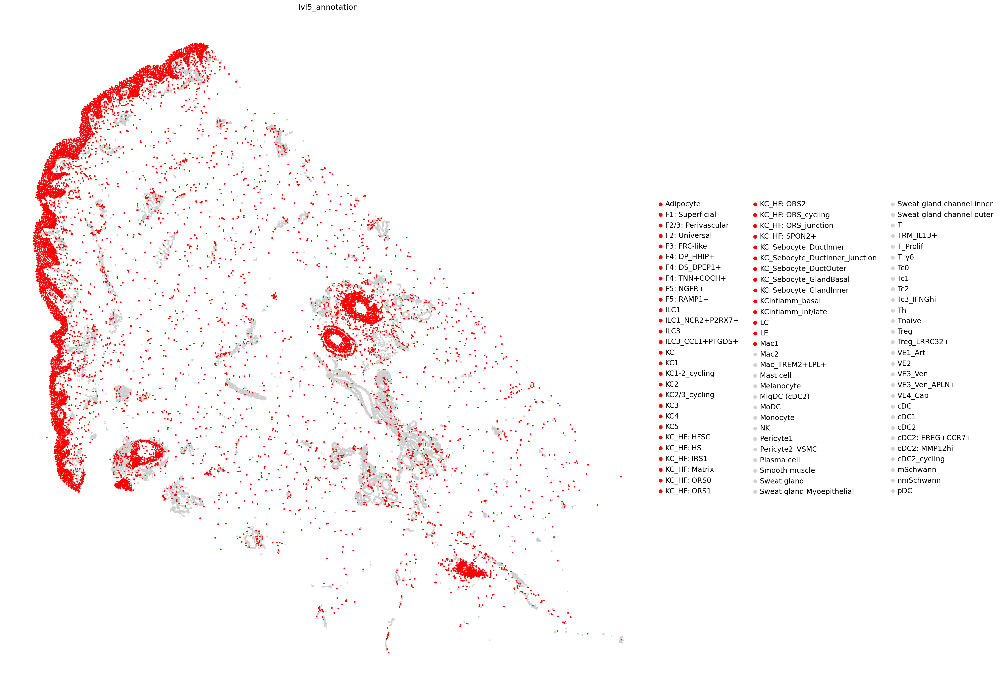

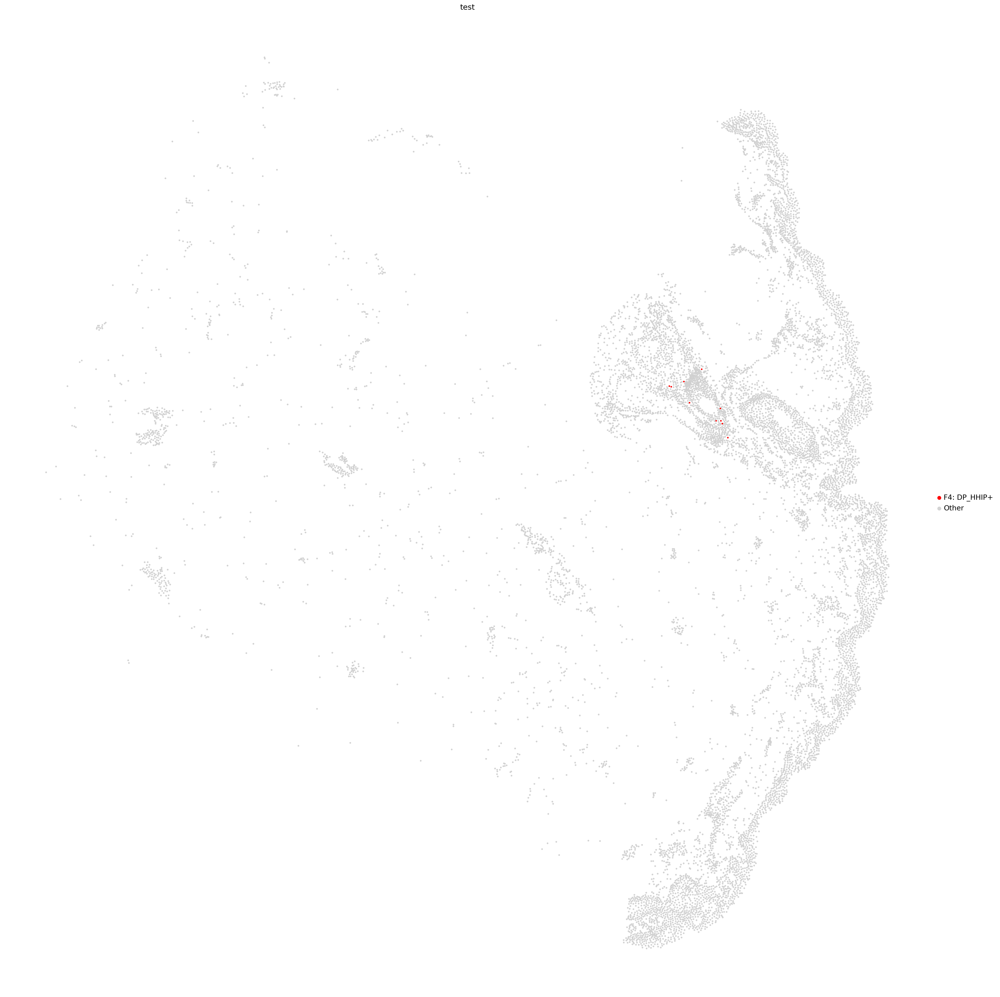

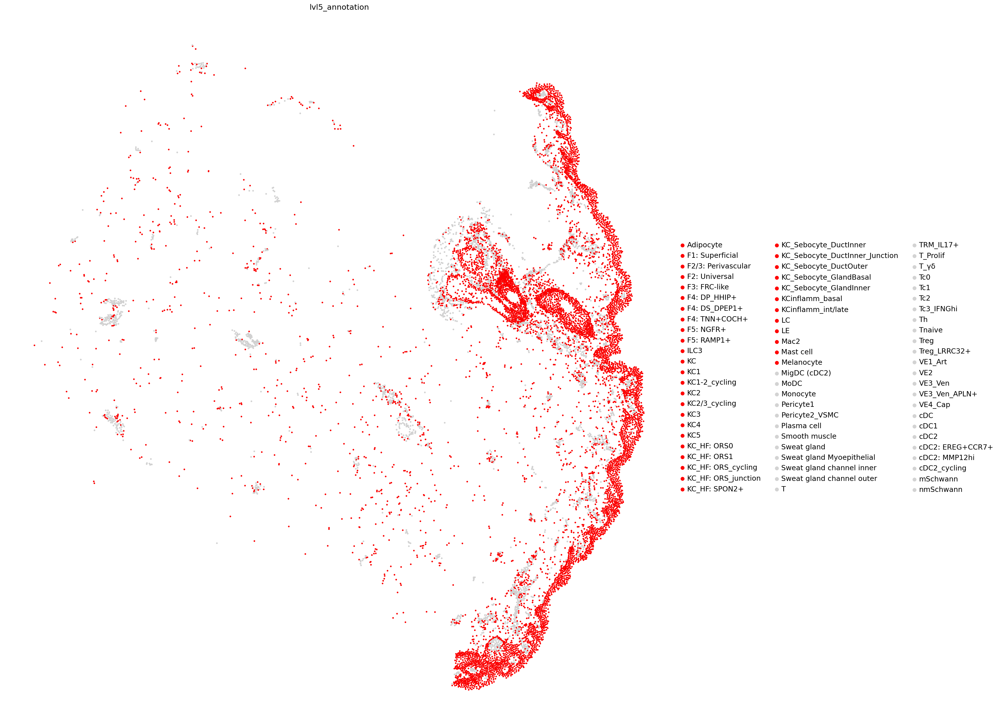

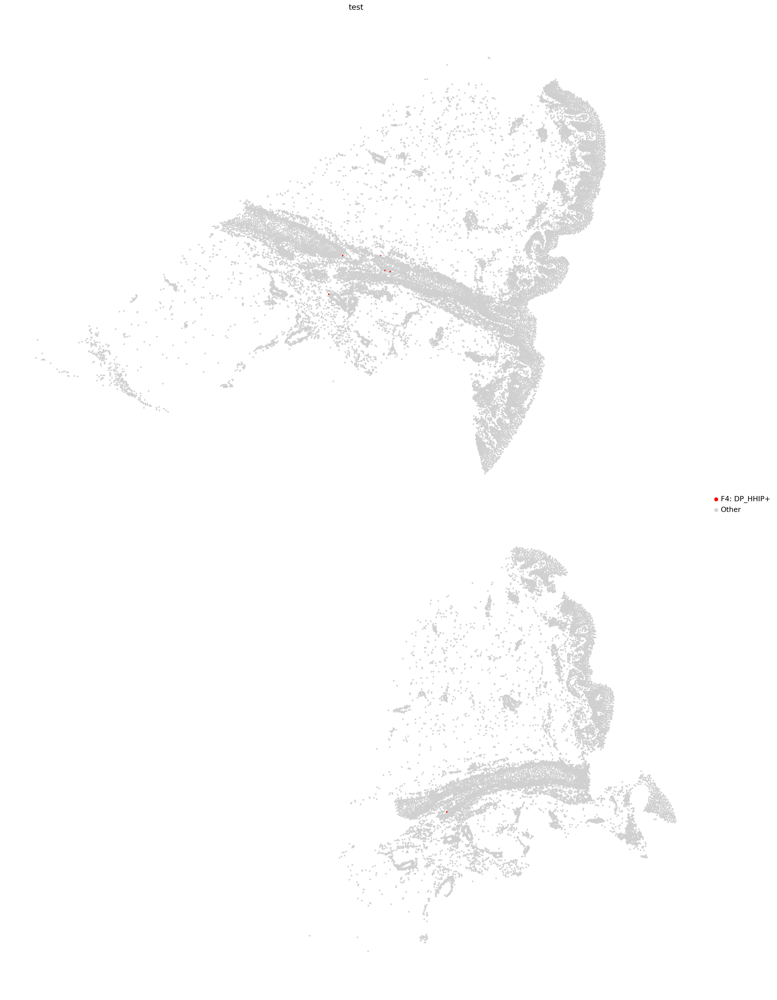

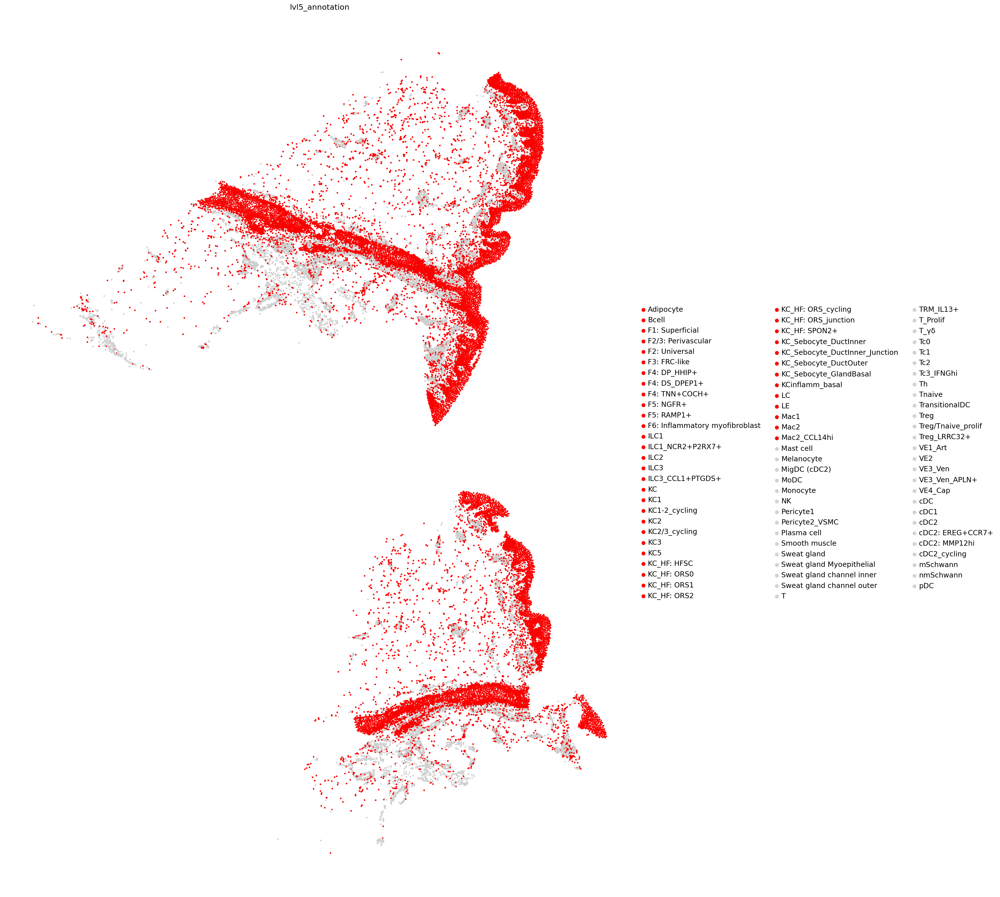

In [41]:

#['Mac', 'Mac_CCL14hi', 'Mac LPLhi', 'Mac_prolif/PreDC', 'Mac LPLhi (P2RY12-)']

CELL_TYPE = 'F4: DP_HHIP+'
MIN_CELL_COUNT=10


i=0

for tissue_section_id in ['Lesional_CE4-SKI-27-FO-4-S22_replicate',
                          '3D_BK25_week12-D2',
                          "BK30_Week 12",
                         "Week 8 (resolved)_CE4-SKI-27-FO-3-S22-E2_a",
                         "BK30_Day 14"]  :
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
    NUM = ord(CELL_TYPE[0])
    if NUM <79:
        custom_palette =ListedColormap([  "red",  "lightgrey"])
    else:
        custom_palette = ListedColormap([  "lightgrey", "red"])
    sq.pl.spatial_scatter(
            adata_i,
            library_id="spatial",
            shape=None,
            color="test",
            size=30,
            vmax=1,
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
            palette=custom_palette,
            edgecolor='black',
            linewidth=0.01,
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
    sq.pl.spatial_scatter(
            adata_i,
            library_id="spatial",
            shape=None,
            color="lvl5_annotation",
            size=30,
            vmax=1,
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
          #  palette=custom_palette,
            edgecolor='black',
            linewidth=0.01,
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break


In [45]:
adata_5k[adata_5k.obs['lvl5_annotation']=="Merkel cell"].obs.info_id6.value_counts().head(5).index

CategoricalIndex(['BK23_Lesional Baseline', 'BK24_Lesional Baseline',
                  'BK23_Week 12', 'BK51_Past Lesional', 'BK49_Past Lesional'],
                 categories=['3D_BK22_Lesional_baseline-A2', '3D_BK22_Lesional_baseline-D1', 'BK18_Non-lesional Baseline', 'BK20_Week 12', ..., 'Lesional_CE6-SKI-28-FO-4-S22_replicate', 'Week 8 (resolved)_CE3-SKI-28-FO-4-S22-E1_a', 'Week 8 (resolved)_CE3-SKI-28-FO-4-S22-E1_b', 'Week 8 (resolved)_CE5-SKI-27-FO-4-S22-E1'], ordered=False, dtype='category', name='info_id6')

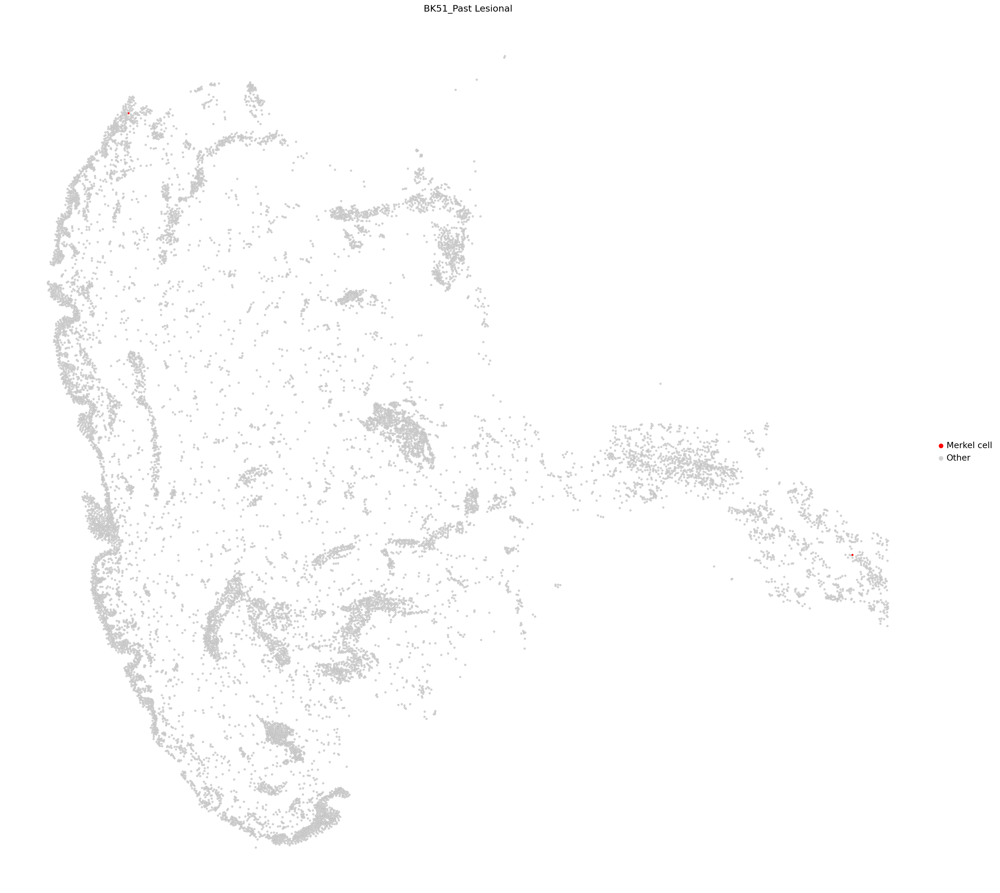

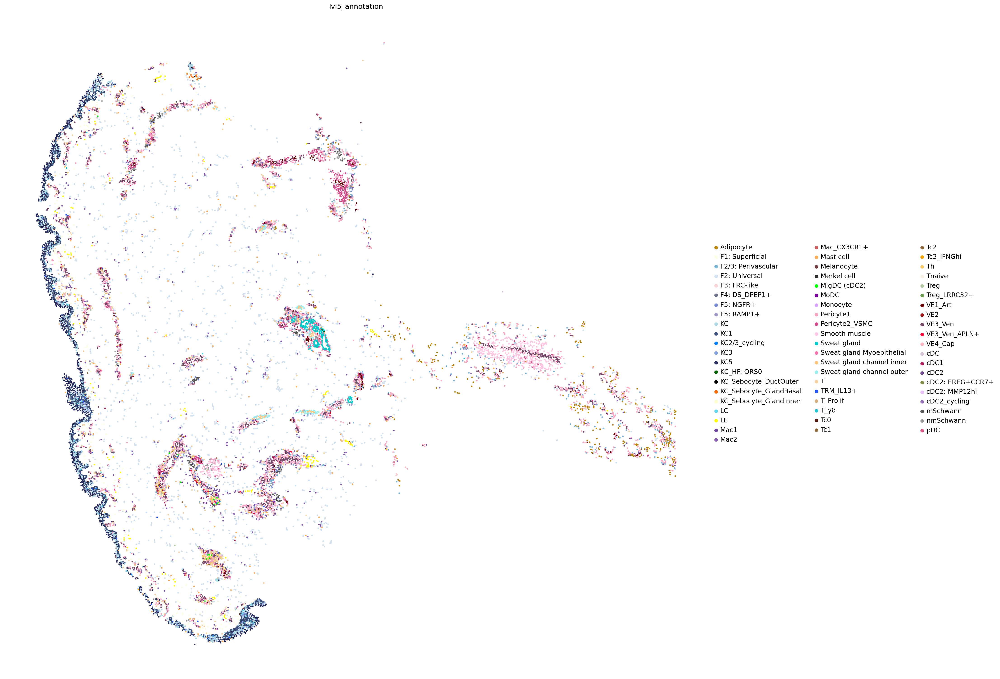

In [56]:

#['Mac', 'Mac_CCL14hi', 'Mac LPLhi', 'Mac_prolif/PreDC', 'Mac LPLhi (P2RY12-)']

CELL_TYPE = 'Merkel cell'
MIN_CELL_COUNT=1


i=0

for tissue_section_id in [ 'BK51_Past Lesional']  :
    adata_i =  adata_5k[adata_5k.obs["info_id6"]==tissue_section_id]
    adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["lvl5_annotation"]]
    NUM = ord(CELL_TYPE[0])
    if NUM <79:
        custom_palette =[  "red",  "lightgrey"]
    else:
        custom_palette = [  "lightgrey", "red"]
    sc.pl.spatial(
            adata_i,
           # library_id="spatial",
           # shape=None,
            color="test",
            spot_size=10,
            vmax=1,
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
            palette=custom_palette,
            edgecolor='black',
            linewidth=0.05,
        title=tissue_section_id,
        save="supp1d_Merkel_cell.pdf"
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
    sc.pl.spatial(
            adata_i,
            #library_id="spatial",
            #shape=None,
            color="lvl5_annotation",
            spot_size=10,
            vmax=1,
            #title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
          #  palette=custom_palette,
            edgecolor='black',
            linewidth=0.01,
            #ax=ax,
            #legend_loc="on data"  # Disable the legend for each subplot
        )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break


0 False
0 True
BK49_Past Lesional wk8 relaspe - Cell count:  1
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  1
0 True
BK46_Never Lesional - Cell count:  2
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  2
0 False
0 True
BK51_wk8 Relapse - Cell count:  2
Lesional  - does not contain  F4: DP_HHIP+ . Count is  2
0 True
BK46_Past Lesional - Cell count:  1
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  1
0 False
0 True
BK43_Never Lesional - Cell count:  4
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  4
0 False
0 True
BK49_Past Lesional - Cell count:  3
Non-lesional  - does not contain  F4: DP_HHIP+ . Count is  3
0 False
0 False
0 False
0 False
0 False
0 True
BK23_Week 12 - Cell count:  1
Week 12  - does not contain  F4: DP_HHIP+ . Count is  1
0 False
0 True
BK23_Lesional Baseline - Cell count:  2
Lesional  - does not contain  F4: DP_HHIP+ . Count is  2
0 False
0 True
BK27_Week 12 - Cell count:  5
Week 12  - does not contain  F4: DP_HHIP+ . Co

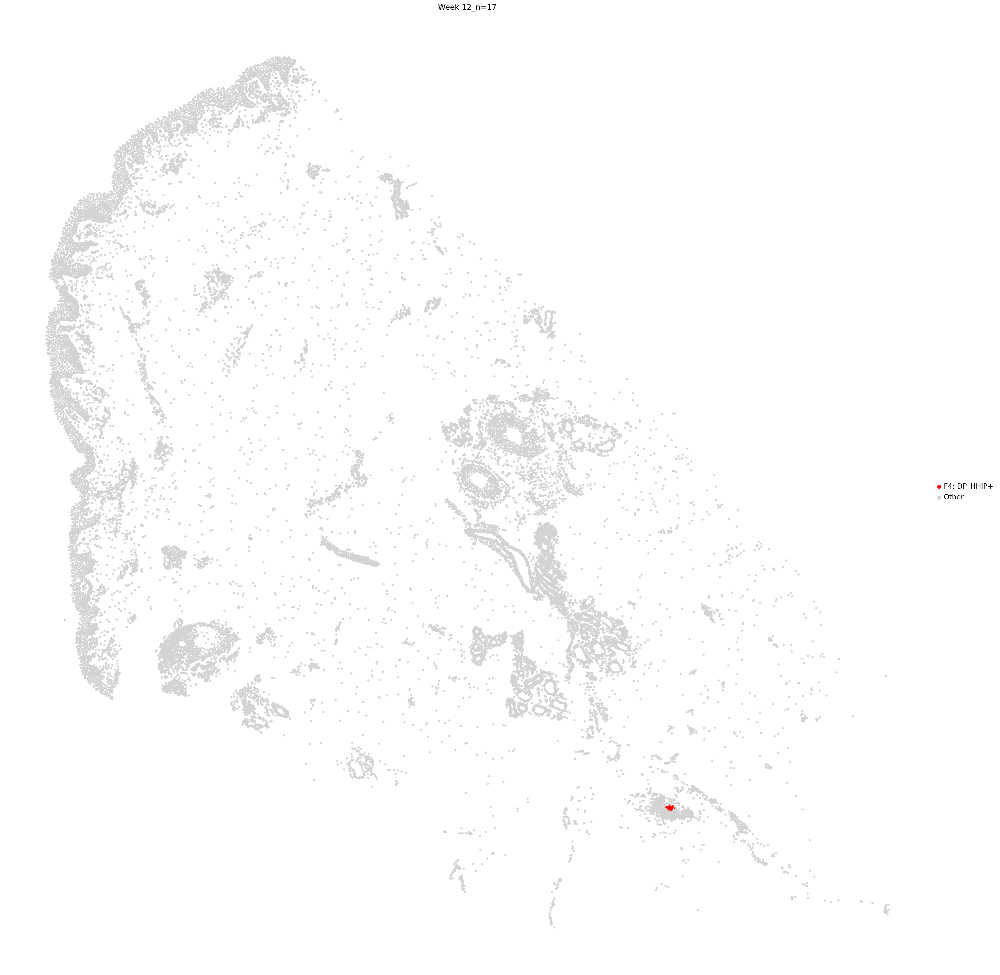

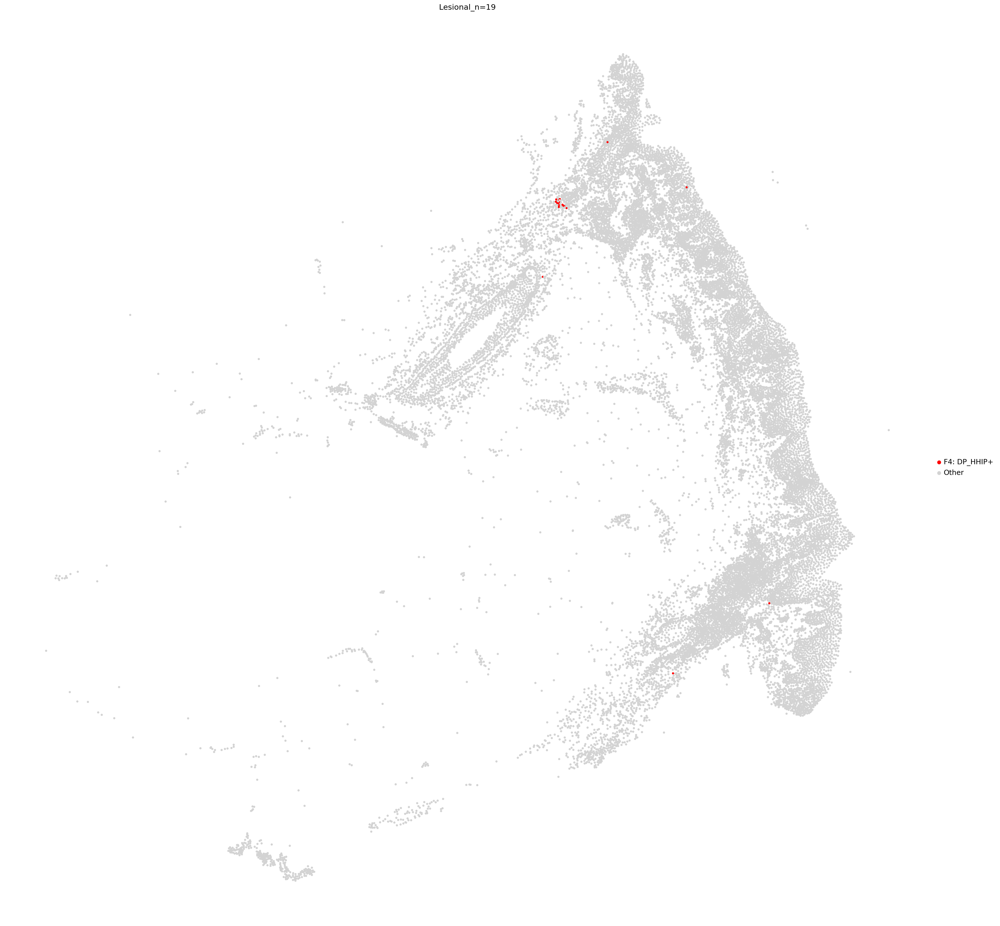

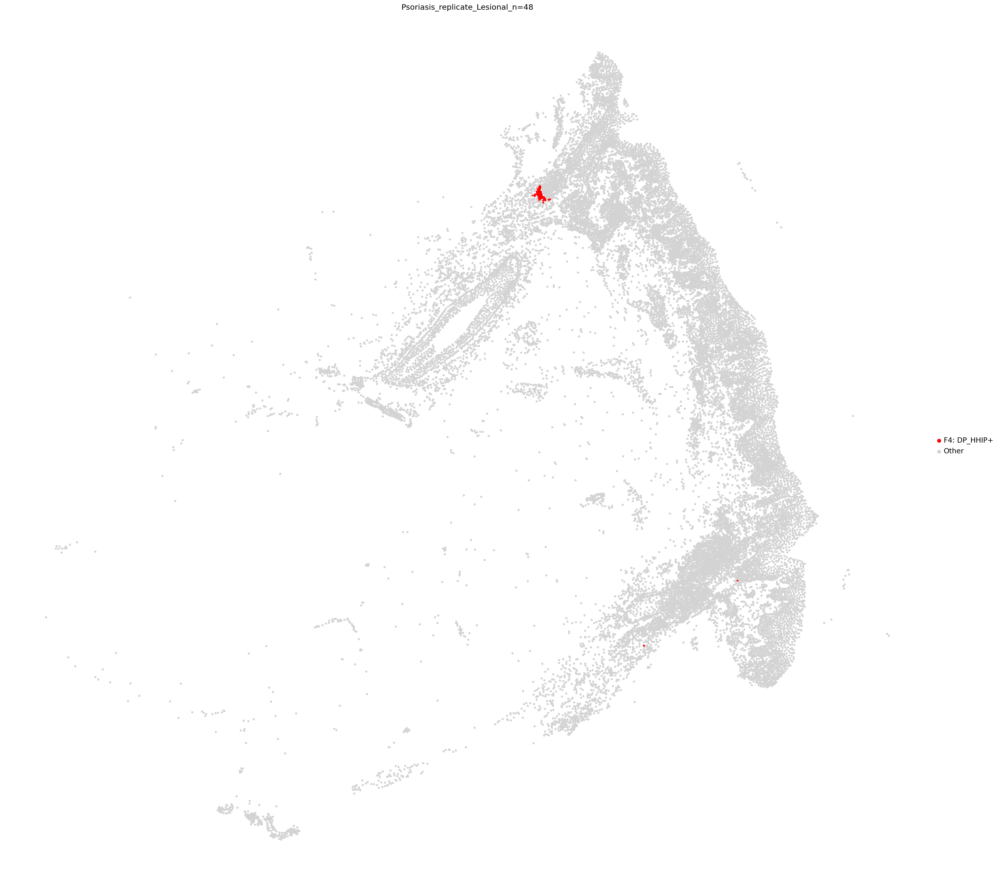

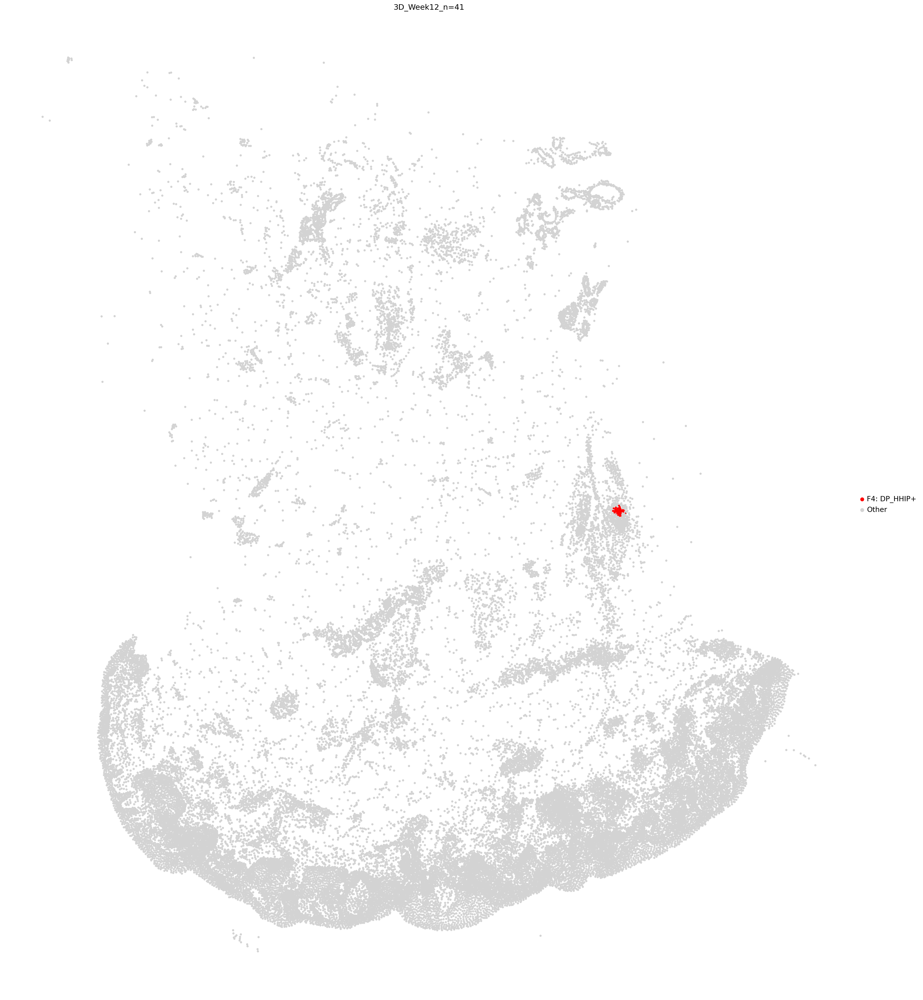

In [32]:

#['Mac', 'Mac_CCL14hi', 'Mac LPLhi', 'Mac_prolif/PreDC', 'Mac LPLhi (P2RY12-)']

CELL_TYPE = 'F4: DP_HHIP+'
MIN_CELL_COUNT=10


i=0
#adata_5k=adata_5k[adata_5k.obs["Site_status_binary"]=="Lesional"]
for tissue_section_id in adata_5k.obs["sample_id"].unique():
    adata_i =  adata_5k[adata_5k.obs["sample_id"]==tissue_section_id]
    niche_names_found = adata_i.obs["Annotation"].unique()
    STATUS =  adata_i.obs["Site_status"].unique()[0]
    print(i, CELL_TYPE in niche_names_found)
#     if tissue_section_id=="output-XETG00335__0044073__BK49-SKI-24-FO-1-s2_BK50-SKI-27-FO-1-s2__20250210__163417":
#         print(tissue_section_id)
#         display(adata_i.obs["Annotation"].value_counts())
    if CELL_TYPE in niche_names_found:
        CELL_COUNT_IN_SECTION=adata_i[adata_i.obs["Annotation"]==CELL_TYPE].shape[0]
        print(tissue_section_id, "- Cell count: ", CELL_COUNT_IN_SECTION)

        if CELL_COUNT_IN_SECTION > MIN_CELL_COUNT:
    #         if i ==0:

    #             sq.pl.spatial_scatter(
    #                 adata_i,
    #                 library_id="spatial",
    #                 shape=None,
    #                 color="Annotation",
    #                 size=1,
    #                 vmax=1,
    #                 title=tissue_section_id,
    #                 #ax=ax,
    #                 #legend_loc="on data"  # Disable the legend for each subplot
    #             )       
            i=i+1

            #print(tissue_section_id)
    #         sq.pl.spatial_scatter(
    #             adata_i,
    #             library_id="spatial",
    #             shape=None,
    #             color="Annotation",
    #             size=5,
    #             vmax=1,
    #             title=tissue_section_id,
    #             #ax=ax,
    #             legend_loc="on data"  # Disable the legend for each subplot
    #         )
            adata_i.obs["test"] = [x if x == CELL_TYPE else "Other" for x in adata_i.obs["Annotation"]]
            NUM = ord(CELL_TYPE[0])
            if NUM <79:
                custom_palette =ListedColormap([  "red",  "lightgrey"])
            else:
                custom_palette = ListedColormap([  "lightgrey", "red"])
            sq.pl.spatial_scatter(
                    adata_i,
                    library_id="spatial",
                    shape=None,
                    color="test",
                    size=30,
                    vmax=1,
                    title=STATUS + "_n=" + str(CELL_COUNT_IN_SECTION),
                    palette=custom_palette,

                    #ax=ax,
                    #legend_loc="on data"  # Disable the legend for each subplot
                )
#             if i >5:
#                 print("6 samples found already ... Terminate")
#                 break
        else:
             print(STATUS, " - does not contain ", CELL_TYPE, ". Count is " , CELL_COUNT_IN_SECTION,)# " - i=", i)